In [33]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

In [34]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

# 1. Prepare

In [1]:
import math
from sklearn.metrics import classification_report
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow, imread, imsave, figure
import pandas as pd
import numpy as np
import os
import sys
from skimage.color import rgb2gray
from skimage.transform import rescale, resize

#Keras:
import keras
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import LearningRateScheduler
from keras.optimizers import SGD
from keras.models import *
from keras.layers import *
from keras.optimizers import *
from keras.callbacks import ModelCheckpoint, LearningRateScheduler

#Custom Functions:
ROOT_DIR = os.path.abspath("../")
sys.path.append(ROOT_DIR)

from imports.utils.log_progress import log_progress
from imports.utils.visualization import Visualize
from imports.utils.enums import DATA_BASE_PATH, SHAPE
from imports.models.u_net import get_unet

DATA_IMAGE_PATH = DATA_BASE_PATH + '/Images'
DATA_MASK_PATH = DATA_BASE_PATH + '/Masks'

Using TensorFlow backend.


In [2]:
import warnings
warnings.filterwarnings("ignore")

### Check if GPU available:

In [3]:
from keras import backend as K
K.tensorflow_backend._get_available_gpus()

['/job:localhost/replica:0/task:0/device:GPU:0']

### Read Dataframes:

In [10]:
train_df = pd.read_pickle(DATA_BASE_PATH+"/train_df")
val_df = pd.read_pickle(DATA_BASE_PATH+"/val_df")
test_df = pd.read_pickle(DATA_BASE_PATH+"/test_df")
train_df.head(3)

,Path,Name,Rle-Encoding,Roots,Splines,Shape
0,../data/LabelingTool/Prozessschritte_03,20160913D_hamt116_Ampfer-raw.png,71010 9 72158 15 73307 19 74457 21 75608 22 76...,"[(675.71, 1050.151), (930.5921, 405.1768), (89...","[[(800.8137, 67.08368), (812.5817, 97.1123), (...","(1738, 1151)"
1,../data/LabelingTool/Prozessschritte_08,20160914D_hamt205_Ampfer-raw.png,491844 10 492991 18 494140 21 495289 24 496439...,"[(496.6584, 793.6775), (383.192, 604.691)]","[[(164.8352, 670.2578), (191.2539, 685.0522)],...","(1738, 1151)"
2,../data/LabelingTool/Prozessschritte_09,20161013D_hamt288_Ampfer-raw.png,553630 19 555365 25 557101 30 558838 33 560575...,"[(761.6401, 516.4299)]","[[(544.6418, 563.2201), (672.8065, 540.1641)],...","(1151, 1738)"


### If Available, load existing Model:

In [5]:
from imports.models.losses import bce_dice_loss, dice_coeff
from keras.models import load_model, model_from_json

import keras.losses
keras.losses.custom_loss = bce_dice_loss

model = load_model('../saved_models/unet/unet1024_40epochs.h5', custom_objects={'bce_dice_loss': bce_dice_loss,'dice_coeff':dice_coeff})

# 2. Visualize

### 2.1 Show Samples of trained Model on UNSEEN Data:

In [17]:
vis_params = {'data_set':'val',
              'model':model}

visualize = Visualize(**vis_params)

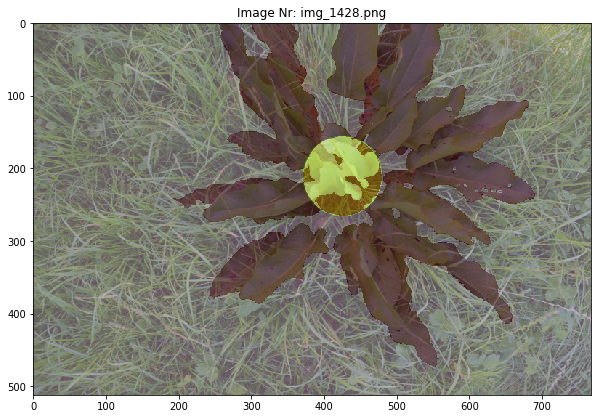

In [25]:
img, pred = visualize.show_single(index='1428',mode='image_prediction_error')

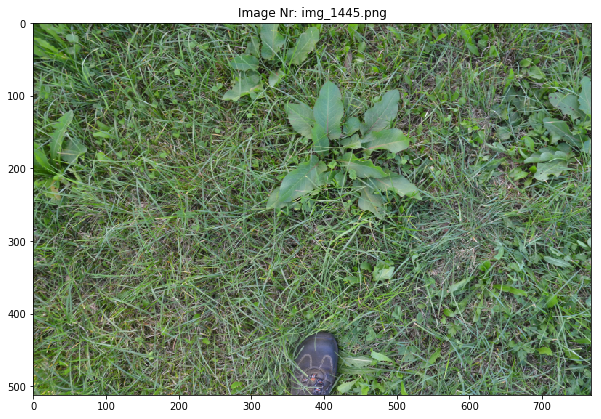

In [19]:
_,_ = visualize.show_single(index='1445',mode='image')

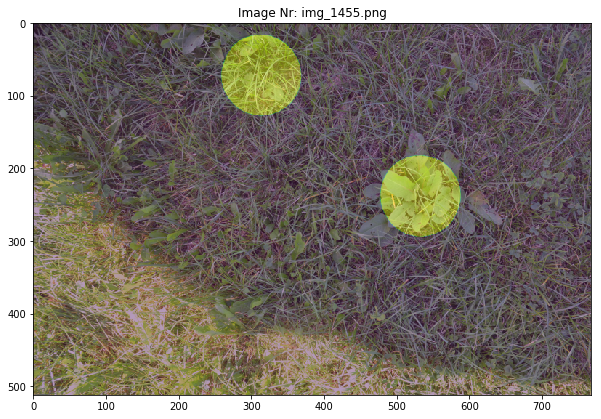

In [20]:
pred = visualize.show_single(index='1455',mode='image_prediction')

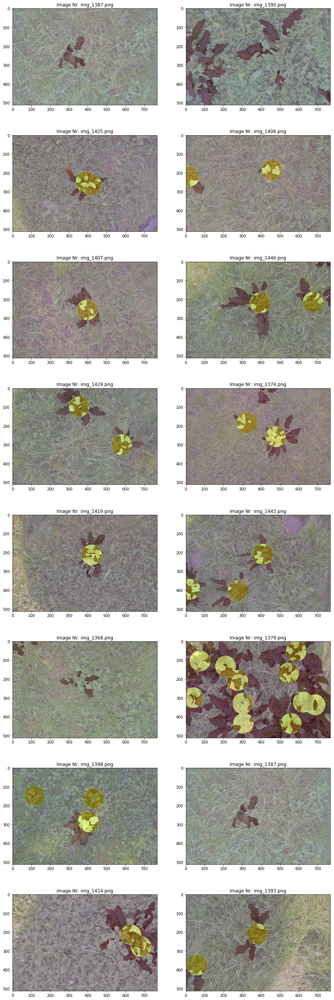

In [26]:
visualize.show_matrix(index='random',mode='image_prediction_error',rows=8)

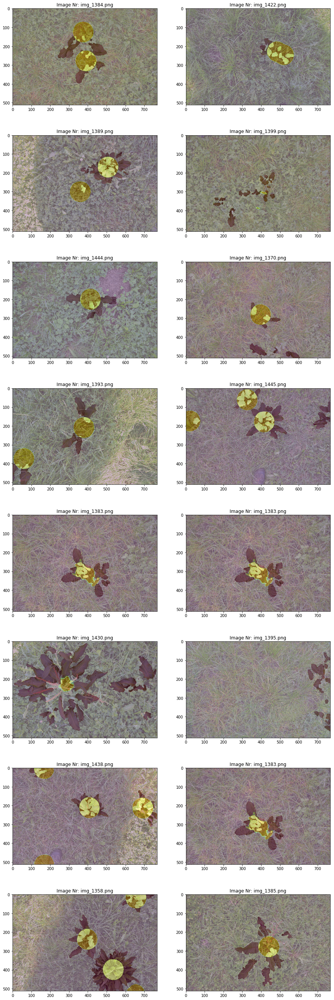

In [28]:
visualize.show_matrix(index='random',mode='image_prediction_error',rows=8)

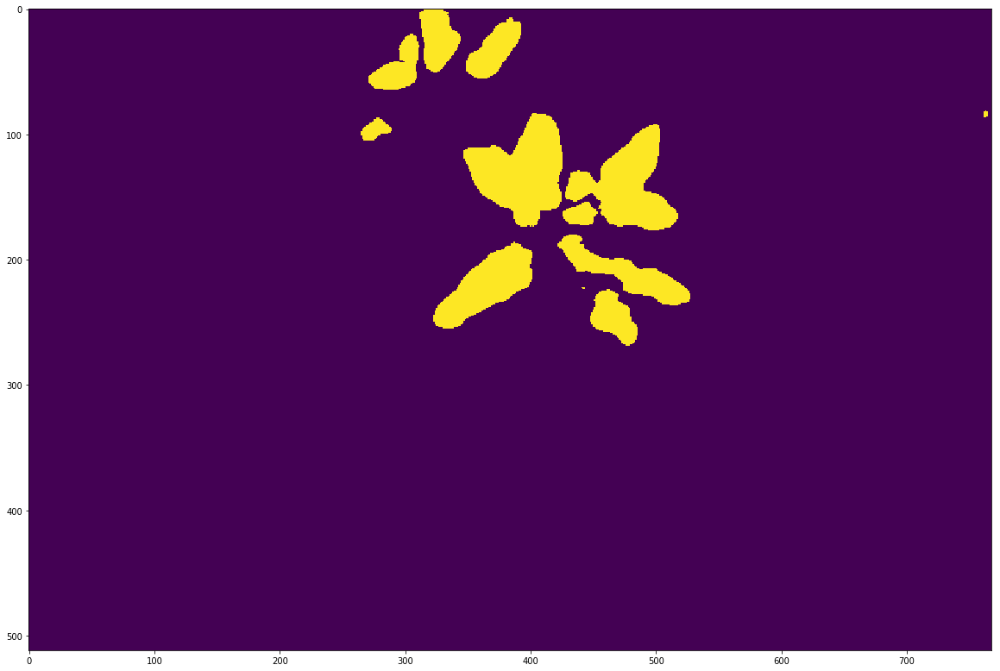

In [9]:
plt.figure(figsize=(20,20))
imshow(pred>0.98)

In [14]:
from scipy import ndimage
a=(40,40)
min(a)

40

Text(0.5,1,'Separated objects')

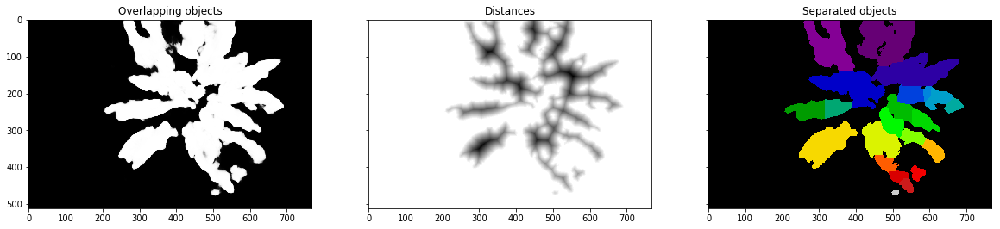

In [8]:
def watershed_segmentation(prediction_image,threshold=0.90,footprint_size=(40,40)):
    from scipy import ndimage as ndi
    from skimage.morphology import watershed
    from skimage.feature import peak_local_max
    from skimage.draw import circle
    circle_img = np.zeros(footprint_size, dtype=np.uint8)
    rr, cc = circle(footprint_size[0]/2, footprint_size[1]/2,min(footprint_size)/2-2)
    circle_img[rr, cc] = 1
    
    # Now we want to separate the two objects in image
    # Generate the markers as local maxima of the distance to the background
    pred_logical = prediction_image>threshold
    distance = ndi.distance_transform_edt(pred_logical)
    local_maxi = peak_local_max(distance, indices=False, footprint=circle_img, labels=pred_logical)
    markers = ndi.label(local_maxi)[0]
    labels = watershed(-distance, markers, mask=pred_logical)
    
    return distance, labels

distance, labels = watershed_segmentation(pred,footprint_size=(60,60))

fig, axes = plt.subplots(ncols=3, figsize=(20, 20), sharex=True, sharey=True)
ax = axes.ravel()

ax[0].imshow(pred, cmap=plt.cm.gray, interpolation='nearest')
ax[0].set_title('Overlapping objects')
ax[1].imshow(-distance, cmap=plt.cm.gray, interpolation='nearest')
ax[1].set_title('Distances')
ax[2].imshow(labels, cmap=plt.cm.nipy_spectral, interpolation='nearest')
ax[2].set_title('Separated objects')

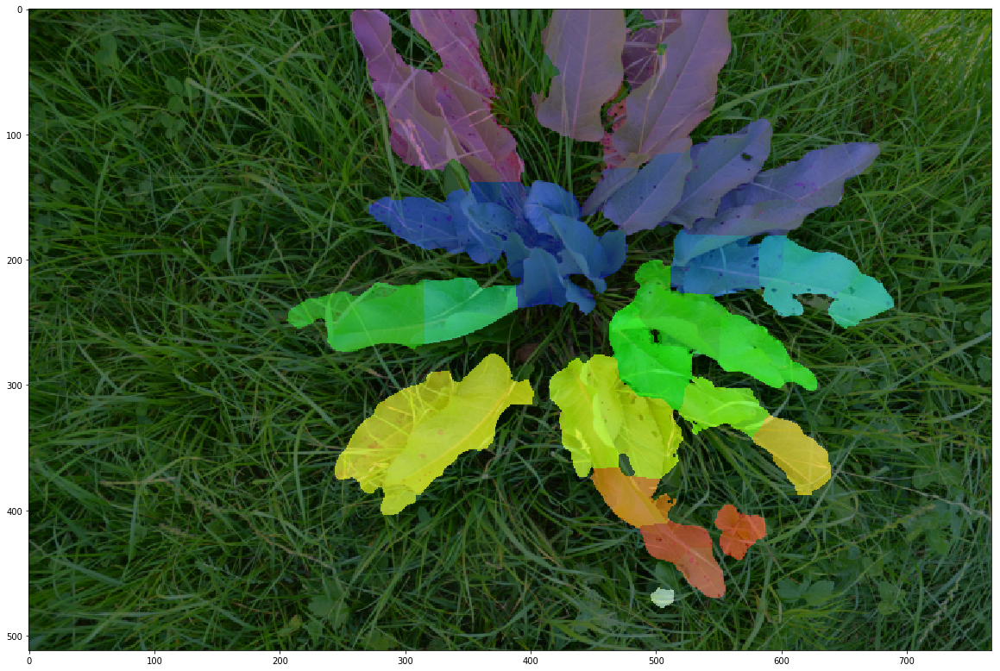

In [19]:
plt.figure(figsize=(20,20))
imshow(labels, cmap=plt.cm.nipy_spectral, interpolation='nearest')
imshow(img,alpha=0.5)

In [29]:
tmp = pred>0.9
y, x = np.nonzero(tmp)
x = x - np.mean(x)
y = y - np.mean(y)
coords = np.vstack([x, y])
cov = np.cov(coords)
evals, evecs = np.linalg.eig(cov)
sort_indices = np.argsort(evals)[::-1]
x_v1, y_v1 = evecs[:, sort_indices[0]]  # Eigenvector with largest eigenvalue
x_v2, y_v2 = evecs[:, sort_indices[1]]


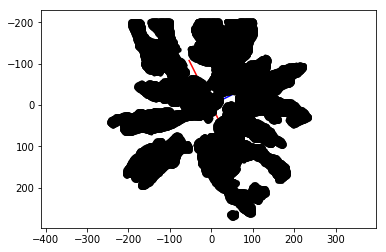

In [34]:
scale = 60
plt.plot([x_v1*-scale*2, x_v1*scale*2],
         [y_v1*-scale*2, y_v1*scale*2], color='red')
plt.plot([x_v2*-scale, x_v2*scale],
         [y_v2*-scale, y_v2*scale], color='blue')
plt.plot(x, y, 'k.')
plt.axis('equal')
plt.gca().invert_yaxis()  # Match the image system with origin at top left
plt.show()

# 3 Training:

### 3.1 Load UNet Model:

In [7]:
model = get_unet(input_shape=(SHAPE[0],SHAPE[1],3))

In [8]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 768, 3)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 768, 8)  224         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 512, 768, 8)  32          conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 512, 768, 8)  0           batch_normalization_1[0][0]      
__________________________________________________________________________________________________
conv2d_2 (

### 3.2 Define Train- Generator:

In [4]:
class DataGenerator(keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, mode, batch_size=2, target_size=SHAPE, shuffle=True):
        'Initialization'
        self.mode = mode
        self.batch_size = batch_size
        self.target_size = target_size
        self.shuffle = shuffle
        self.image_list = None
        self.mask_list = None
        self.__set_directory()
        self.on_epoch_end()
        
    def __set_directory(self):
        if self.mode == 'train':
            self.directory = DATA_BASE_PATH+'/01_Train/'
        if self.mode == 'val':
            self.directory = DATA_BASE_PATH+'/02_Val/'
        if self.mode == 'test':
            self.directory = DATA_BASE_PATH+'/03_Test/'
        if self.mode == 'augmented':
            self.directory = DATA_BASE_PATH+'/Augmented/'
        if self.mode == 'train_roots':
            self.directory = DATA_BASE_PATH+'/01_Train_Roots/'
        if self.mode == 'val_roots':
            self.directory = DATA_BASE_PATH+'/02_Val_Roots/'
        self.image_list = os.listdir(self.directory+'Images/Placken')
        self.mask_list = os.listdir(self.directory+'Masks/Placken')
        assert len(self.image_list) == len(self.mask_list)

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.image_list) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs
        tmp_name_list = [self.image_list[k] for k in indexes]

        # Generate data
        imgs, masks = self.__data_generation(tmp_name_list)

        return imgs, masks

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.image_list))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __data_generation(self, tmp_name_list):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization
        imgs = np.empty((self.batch_size, *self.target_size, 3))
        masks = np.empty((self.batch_size, *self.target_size, 1))

        # Generate data
        for i, name in enumerate(tmp_name_list):
            tmp_img = imread(self.directory+"Images/Placken/"+name)
            tmp_mask = imread(self.directory+"Masks/Placken/"+name)
            tmp_img, tmp_mask = self.__adjust_data(tmp_img, tmp_mask)
            imgs[i,] = resize(tmp_img,(self.target_size[0],self.target_size[1])).reshape(*self.target_size,3)
            masks[i,] = resize(tmp_mask,(self.target_size[0],self.target_size[1])).reshape(*self.target_size,1)
        return imgs, masks
    
    def __adjust_data(self,img,mask):
        if len(mask.shape) == 3:
            mask = mask[:,:,0]
        if img.max() > 1.0:
            img = img / 255
        if mask.max() > 1.0:
            mask = mask /255
        mask[mask > 0.5] = 1
        mask[mask <= 0.5] = 0
        return (img,mask)

#### Generator with drawed Masks:

In [9]:
params = {'target_size': SHAPE,
          'batch_size': 2,
          'shuffle': True}

# Generators
training_generator = DataGenerator(mode='train',**params)
validation_generator = DataGenerator(mode='val',**params)
i = iter(training_generator)

#### Generator with auto generated Masks:

In [5]:
params = {'target_size': SHAPE,
          'batch_size': 4,
          'shuffle': True}

# Generators
training_generator = DataGenerator(mode='train_roots',**params)
validation_generator = DataGenerator(mode='val_roots',**params)
i = iter(training_generator)

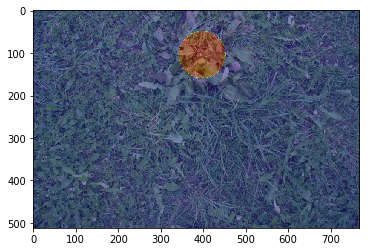

In [29]:
imgs, msks = next(i)
imshow(imgs[0])
imshow(msks[0].reshape(*SHAPE),cmap='jet',alpha=0.5)

In [17]:
BS = 2 

data_gen_args = dict()
trainGen = trainGenerator('train',BS,train_df,data_gen_args,image_augmentation=True)
valGen = trainGenerator('val',BS,val_df,data_gen_args)

In [20]:
img,msk=next(trainGen)


img_1003.png modification: 4


2


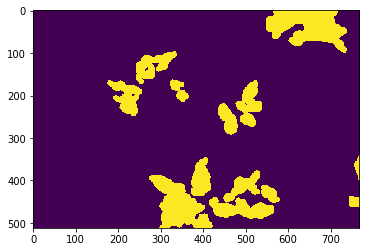

In [228]:
print(len(img))
imshow(msk[0].reshape(*SHAPE))

In [40]:
import imgaug as ia
from imgaug import augmenters as iaa
import imageio

ia.seed(1)

# Load an example image (uint8, 128x128x3).
image = (img[0]*255).astype('uint8')

# Create an example segmentation map (int32, 128x128).
# Here, we just randomly place some squares on the image.
# Class 0 is the background class.
segmap = ia.SegmentationMapOnImage(msk[0], shape=image.shape, nb_classes=1+1)

# Define our augmentation pipeline.
seq = iaa.Sequential([
    iaa.SomeOf((1, 4), [
        iaa.GaussianBlur(sigma=(0, 0.5)),
        iaa.Fliplr(0.5),
        iaa.Flipud(0.5),
        iaa.Affine(rotate=(-45, 45)),  # rotate by -45 to 45 degrees (affects heatmaps)
        iaa.Add((-50, 50), per_channel=0.5),
        iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.05*255), per_channel=0.5),
        iaa.PiecewiseAffine(scale=(0.01, 0.05)),
        iaa.GammaContrast(gamma=0.4,per_channel=False)
    ]),
], random_order=True)

# Augment images and heatmaps.
images_aug = []
segmaps_aug = []
for _ in range(10):
    seq_det = seq.to_deterministic()
    images_aug.append(seq_det.augment_image(image))
    segmaps_aug.append(seq_det.augment_segmentation_maps([segmap])[0])
    

# We want to generate an image of original input images and heatmaps before/after augmentation.
# It is supposed to have five columns: (1) original image, (2) augmented image,
# (3) augmented heatmap on top of augmented image, (4) augmented heatmap on its own in jet
# color map, (5) augmented heatmap on its own in intensity colormap,
# We now generate the cells of these columns.
#
# Note that we add a [0] after each heatmap draw command. That's because the heatmaps object
# can contain many sub-heatmaps and hence we draw command returns a list of drawn sub-heatmaps.
# We only used one sub-heatmap, so our lists always have one entry.
cells = []
for image_aug, segmap_aug in zip(images_aug, segmaps_aug):
    cells.append(image)                                      # column 1
    cells.append(segmap.draw_on_image(image))                # column 2
    cells.append(image_aug)                                  # column 3
    cells.append(segmap_aug.draw_on_image(image_aug))        # column 4
    cells.append(segmap_aug.draw(size=image_aug.shape[:2]))  # column 5
    print()

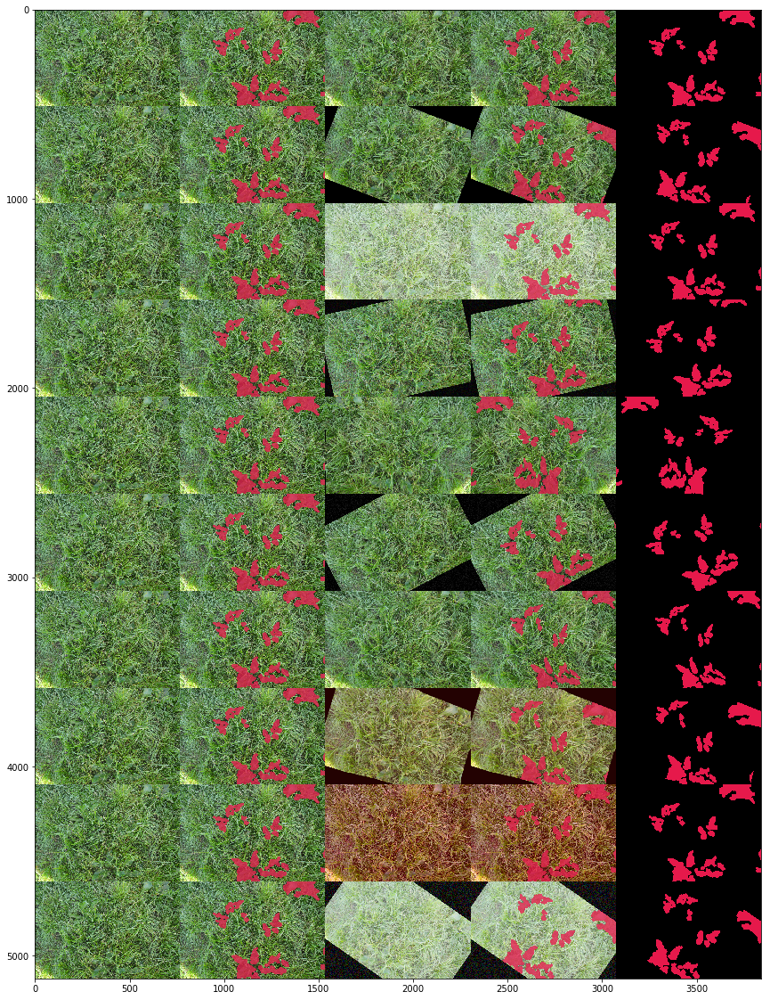

In [39]:
# Convert cells to grid image and save.
grid_image = ia.draw_grid(cells, cols=5)
imageio.imwrite("example_segmaps.jpg", grid_image)
plt.figure(figsize=(20,20))
imshow(grid_image)

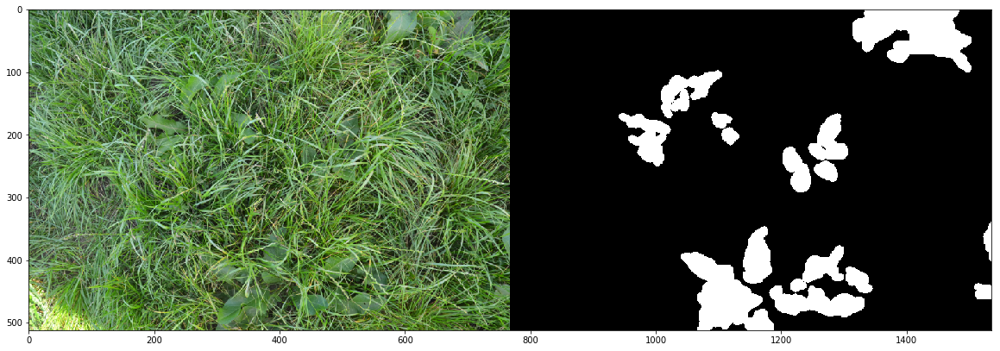

In [92]:
ind = 0
msk_new = np.zeros((*SHAPE,3))
msk_new[:,:,0] = msk[ind,].reshape(*SHAPE)
msk_new[:,:,1] = msk[ind,].reshape(*SHAPE)
msk_new[:,:,2] = msk[ind,].reshape(*SHAPE)
plt.figure(figsize=(20,20))
imshow(np.hstack((img[ind,].reshape(*SHAPE,3),msk_new)))

In [8]:
len(train_df)

354

In [11]:
BS=4
H = model.fit_generator(
    training_generator,
    steps_per_epoch=len(train_df) // BS,
    validation_data=validation_generator,
    validation_steps=len(val_df) // BS,
    epochs=60,
    verbose=1,
    use_multiprocessing=False,
    workers=1)

Epoch 1/60
88/88 [==============================] - 155s 2s/step - loss: 1.6424 - dice_coeff: 0.0976 - val_loss: 1.6633 - val_dice_coeff: 0.1036
Epoch 2/60
88/88 [==============================] - 135s 2s/step - loss: 1.5109 - dice_coeff: 0.1018 - val_loss: 2.5601 - val_dice_coeff: 0.1155
Epoch 3/60
88/88 [==============================] - 135s 2s/step - loss: 1.4527 - dice_coeff: 0.1142 - val_loss: 1.8392 - val_dice_coeff: 0.1350
Epoch 4/60
88/88 [==============================] - 135s 2s/step - loss: 1.4109 - dice_coeff: 0.1241 - val_loss: 1.6801 - val_dice_coeff: 0.1334
Epoch 5/60
88/88 [==============================] - 134s 2s/step - loss: 1.3836 - dice_coeff: 0.1331 - val_loss: 1.4221 - val_dice_coeff: 0.1397
Epoch 6/60
88/88 [==============================] - 134s 2s/step - loss: 1.3621 - dice_coeff: 0.1393 - val_loss: 1.3673 - val_dice_coeff: 0.1406
Epoch 7/60
88/88 [==============================] - 135s 2s/step - loss: 1.3375 - dice_coeff: 0.1500 - val_loss: 1.3185 - val_dice

88/88 [==============================] - 135s 2s/step - loss: 0.5992 - dice_coeff: 0.5029 - val_loss: 0.9079 - val_dice_coeff: 0.2969
Epoch 58/60
88/88 [==============================] - 135s 2s/step - loss: 0.5832 - dice_coeff: 0.5154 - val_loss: 0.9107 - val_dice_coeff: 0.2907
Epoch 59/60
88/88 [==============================] - 135s 2s/step - loss: 0.5725 - dice_coeff: 0.5235 - val_loss: 0.9212 - val_dice_coeff: 0.2733
Epoch 60/60
88/88 [==============================] - 136s 2s/step - loss: 0.5536 - dice_coeff: 0.5369 - val_loss: 0.8849 - val_dice_coeff: 0.3114


In [12]:
model.save('unet1024_60epochs_roots.h5')

dict_keys(['val_loss', 'val_dice_coeff', 'loss', 'dice_coeff'])


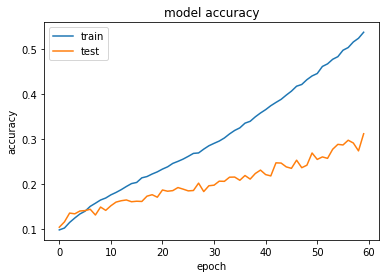

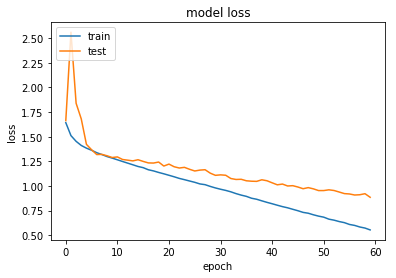

In [13]:
history = H
print(history.history.keys())
# summarize history for accuracy
plt.plot(history.history['dice_coeff'])
plt.plot(history.history['val_dice_coeff'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [14]:
BS=4
H = model.fit_generator(
    training_generator,
    steps_per_epoch=len(train_df) // BS,
    validation_data=validation_generator,
    validation_steps=len(val_df) // BS,
    epochs=60,
    verbose=1,
    use_multiprocessing=False,
    workers=1)

Epoch 1/60
88/88 [==============================] - 138s 2s/step - loss: 0.5469 - dice_coeff: 0.5407 - val_loss: 0.8993 - val_dice_coeff: 0.3035
Epoch 2/60
88/88 [==============================] - 136s 2s/step - loss: 0.5340 - dice_coeff: 0.5504 - val_loss: 0.8794 - val_dice_coeff: 0.3010
Epoch 3/60
88/88 [==============================] - 134s 2s/step - loss: 0.5167 - dice_coeff: 0.5642 - val_loss: 0.9368 - val_dice_coeff: 0.2444
Epoch 4/60
88/88 [==============================] - 134s 2s/step - loss: 0.5016 - dice_coeff: 0.5756 - val_loss: 0.8843 - val_dice_coeff: 0.2939
Epoch 5/60
88/88 [==============================] - 134s 2s/step - loss: 0.4878 - dice_coeff: 0.5867 - val_loss: 0.8679 - val_dice_coeff: 0.3164
Epoch 6/60
88/88 [==============================] - 134s 2s/step - loss: 0.4787 - dice_coeff: 0.5930 - val_loss: 0.8679 - val_dice_coeff: 0.3174
Epoch 7/60
88/88 [==============================] - 134s 2s/step - loss: 0.4622 - dice_coeff: 0.6065 - val_loss: 0.8777 - val_dice

88/88 [==============================] - 134s 2s/step - loss: 0.0816 - dice_coeff: 0.9322 - val_loss: 1.0485 - val_dice_coeff: 0.2142
Epoch 58/60
88/88 [==============================] - 134s 2s/step - loss: 0.0783 - dice_coeff: 0.9352 - val_loss: 0.9046 - val_dice_coeff: 0.3397
Epoch 59/60
88/88 [==============================] - 134s 2s/step - loss: 0.0745 - dice_coeff: 0.9385 - val_loss: 0.8985 - val_dice_coeff: 0.3484
Epoch 60/60
88/88 [==============================] - 134s 2s/step - loss: 0.0745 - dice_coeff: 0.9388 - val_loss: 0.8888 - val_dice_coeff: 0.3602


In [15]:
model.save('unet1024_120epochs_roots.h5')

dict_keys(['val_loss', 'val_dice_coeff', 'loss', 'dice_coeff'])


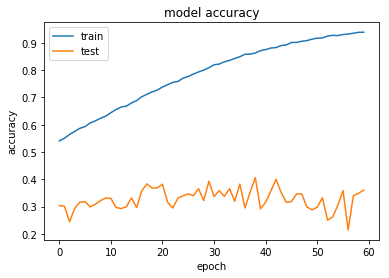

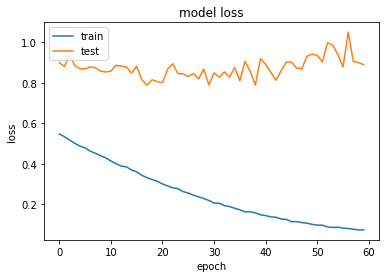

In [16]:
history = H
print(history.history.keys())
# summarize history for accuracy
plt.plot(history.history['dice_coeff'])
plt.plot(history.history['val_dice_coeff'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

### Old Results:

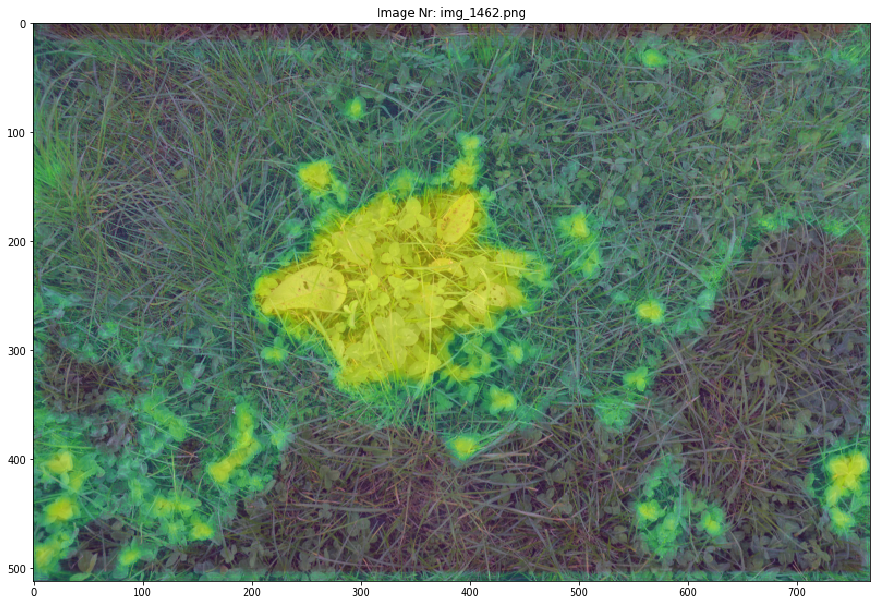

In [51]:
visualize.show(index='random',mode='image_prediction',save_dir=DATA_BASE_PATH+"/SaveDir/")

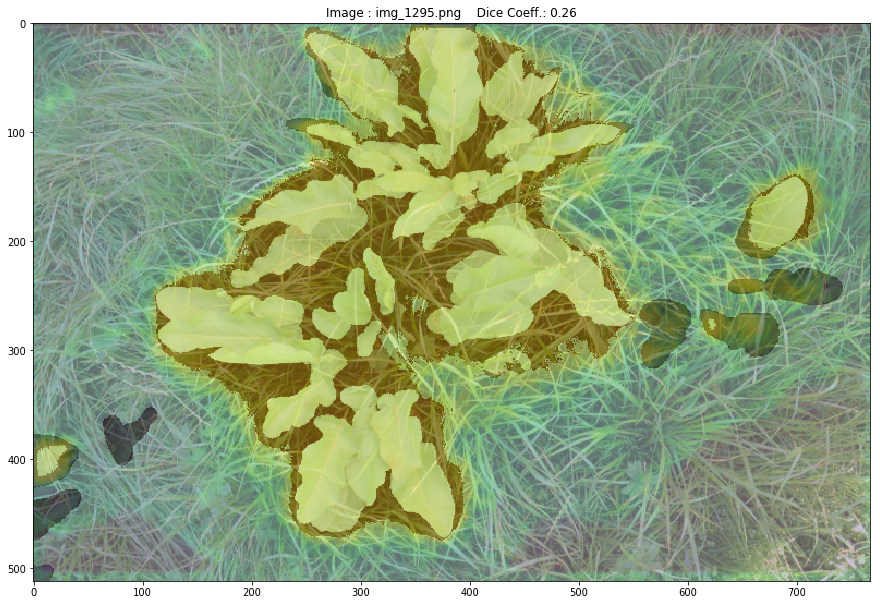

In [44]:
visualize.show(index='random',mode='image_prediction_error')

In [ ]:
visualize.show(index='random',mode='image_prediction_error')

In [17]:
def get_model_memory_usage(batch_size, model):
    import numpy as np
    from keras import backend as K

    shapes_mem_count = 0
    for l in model.layers:
        single_layer_mem = 1
        for s in l.output_shape:
            if s is None:
                continue
            single_layer_mem *= s
        shapes_mem_count += single_layer_mem

    trainable_count = np.sum([K.count_params(p) for p in set(model.trainable_weights)])
    non_trainable_count = np.sum([K.count_params(p) for p in set(model.non_trainable_weights)])

    number_size = 4.0
    if K.floatx() == 'float16':
         number_size = 2.0
    if K.floatx() == 'float64':
         number_size = 8.0

    total_memory = number_size*(batch_size*shapes_mem_count + trainable_count + non_trainable_count)
    gbytes = np.round(total_memory / (1024.0 ** 3), 3)
    return gbytes

print(get_model_memory_usage(4, model)*1000)

2038.0


old:

In [ ]:
def AugmentData(image,mask,number_images=10,seed=1):
    import imgaug as ia
    from imgaug import augmenters as iaa
    import imageio
    ia.seed(seed)
    # Load an example image (uint8, 128x128x3).
    if image.max() <= 1.0:
        image = (image*255).astype('uint8')

    # Create an example segmentation map (int32, 128x128).
    # Here, we just randomly place some squares on the image.
    # Class 0 is the background class.
    segmap = ia.SegmentationMapOnImage(mask, shape=image.shape, nb_classes=1+1)

    # Define our augmentation pipeline.
    seq = iaa.Sequential([
        iaa.SomeOf((1, 4), [
            iaa.GaussianBlur(sigma=(0, 0.5)),
            iaa.Fliplr(0.5),
            iaa.Flipud(0.5),
            iaa.Affine(rotate=(-45, 45)),  # rotate by -45 to 45 degrees (affects heatmaps)
            iaa.Add((-50, 50), per_channel=0.5),
            iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.05*255), per_channel=0.5),
            iaa.PiecewiseAffine(scale=(0.01, 0.05)),
            iaa.GammaContrast(gamma=0.4,per_channel=False)
        ]),
    ], random_order=True)

    # Augment images and heatmaps.
    images_aug = []
    segmaps_aug = []
    for _ in range(number_images):
        seq_det = seq.to_deterministic()
        images_aug.append(seq_det.augment_image(image))
        mask = seq_det.augment_segmentation_maps([segmap])[0]
        mask = mask.draw(size=image.shape[:2])
        segmaps_aug.append(mask)
        #print(seq_det.augment_segmentation_maps([segmap])[0].shape)
        
    return images_aug, segmaps_aug
    

def adjustData(img,mask):
    if img.max() > 1.0:
        img = img / 255
    if mask.max() > 1.0:
        mask = mask /255
    mask[mask > 0.5] = 1
    mask[mask <= 0.5] = 0
    return (img,mask)

def adjustData_aug(images_aug, segmaps_aug):
    images_aug_new = []
    masks_aug_new = []
    
    for image_aug, segmap_aug in zip(images_aug, segmaps_aug):
        img = image_aug
        mask = segmap_aug[:,:,0].reshape(*SHAPE,1)
        if img.max() > 1.0:
            img = img / 255
        if mask.max() > 1.0:
            mask = mask /255
        mask[mask > 0.5] = 1
        mask[mask <= 0.5] = 0
        images_aug_new.append(img)
        masks_aug_new.append(mask)
    
    return (images_aug_new,masks_aug_new)

def trainGenerator(training_set,batch_size,dataframe,aug_dict,image_augmentation = False,
                   save_to_dir = None,target_size = SHAPE,seed = 1,mode='train'):
    
    if training_set == 'train':
        directory = DATA_BASE_PATH+'/01_Train/'
    if training_set == 'val':
        directory = DATA_BASE_PATH+'/02_Val/'
    if training_set == 'test':
        directory = DATA_BASE_PATH+'/03_Test/'
    if training_set == 'augmented':
        directory = DATA_BASE_PATH+'/Augmented/'
        
    image_list = os.listdir(directory+'Images/Placken')
    mask_list = os.listdir(directory+'Masks/Placken')
    N = len(image_list)
    i = 0
    while True:
        # initialize our batches of images and labels
        images = []
        masks = []
        image = imread(directory+'Images/Placken/'+image_list[i])
        image = resize(image,(SHAPE[0],SHAPE[1])).reshape(*SHAPE,3)
        mask = imread(directory+'Masks/Placken/'+mask_list[i])
        mask = resize(mask,(SHAPE[0],SHAPE[1])).reshape(*SHAPE,1)
        
        if image_augmentation == True:
            images_aug, masks_aug = AugmentData(image,mask)
            images_aug, masks_aug = adjustData_aug(images_aug,masks_aug)
            #print(len(masks_aug))
            j = 0
            while True:
                images = images_aug[j:j+batch_size]
                masks = masks_aug[j:j+batch_size]
                j += batch_size
                if j > len(images_aug):
                    i = i+1
                    break
                print('\n' + str(image_list[i])+ ' modification: ' + str(j))
                yield np.array(images), np.array(masks)
        else:
            while len(images) < batch_size:
                i = i+1
                if i == N:
                    i = 0
                    if mode == 'val' or mode == 'test':
                        break
                            # update our corresponding batches lists
                image,mask = adjustData(image,mask)
                images.append(image)
                masks.append(mask)

            # yield the batch to the calling function
            yield np.array(images), np.array(masks)